<a href="https://colab.research.google.com/github/YarekAlejandro/Transformada-de-Arnold/blob/main/Transformada_de_Arnold.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Empleo de Transformada de Arnold para problemas de Encriptado de Imagenes ㊙

## Importación de Bibliotecas Necesarias 📚

In [ ]:
# Importar las Bibliotecas necesarias
import sys
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

### Función de reescalado de imagen

In [ ]:
def reescalado_imagen(max_px: int):
  max_px = int(max_px)
  new_size = input(f"\nEscribe el reescalado de la imagen. Debe ser menor a ({max_px} x {max_px}) px\n")
  if new_size.isnumeric():
    return (int(new_size), int(new_size))
  else:
    sys.exit("La imagen debe tener dimensiones cuadradas")

## Comprobación de imagen original [image.extension] 🔍

Esta es nuestra imagen original.

Escribe el reescalado de la imagen. Debe ser menor a (3000 x 3000) px
2000
Sus dimensiones son: 2000x2000 píxeles



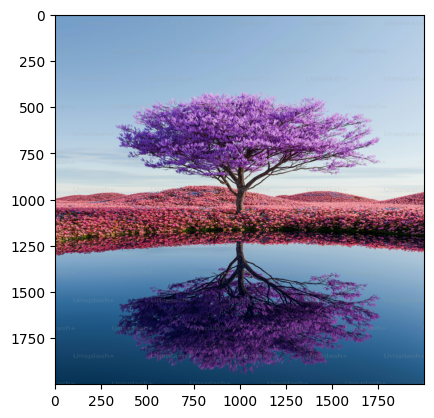

In [ ]:
print("Esta es nuestra imagen original.")

img = Image.open('image.jpg')

if img.size[0] != img.size[1]:
  img = img.resize(reescalado_imagen(min(img.size[0], img.size[1])))

print(f"Sus dimensiones son: \033[1m{img.size[0]}x{img.size[1]} píxeles\033[0m\n")
plt.imshow(np.array(img)) # Mostrar imagen

## Función de Encriptado/Desencriptado (Transformada de Arnold) 🔐

In [ ]:
def obtener_pixeles(img1, img2):
  return [img1.load(), img2.load()]

def nueva_imagen(width, height):
  return Image.new("RGB", (width, height), (255, 255, 255)) # Crear nueva imagen (lienzo en blanco)

def iniciar_transformada(iteraciones: int, modo: str, img_encriptada): # Número de iteraciones, Modo ("Encriptado", "Desencriptado")
  modo = modo.strip().lower() #Insensibilizar Mayúsculas
  itr_interno = 0 # Contador de iteraciones interno
  if modo != "encriptar" and modo.strip().lower() != "desencriptar":
    sys.exit("El modo debe ser 'encriptar' o 'desencriptar'")
  print(f"Iniciando proceso de {modo}")
  for _ in range(iteraciones):
    n = img_encriptada.size[0] # n es la cantidad de píxeles en el borde de la imagen. Al ser una imagen cuadrada, es igual en todos los bordes. (Ej. 600 x 600)
    img_n, img_blanco = (img_encriptada, nueva_imagen(n, n)) # width, height (Cuadrada)
    pixel = obtener_pixeles(img_n, img_blanco)
    for i in range(n):
      for j in range(n):
        pos = [i, j] # Posición del píxel a transformar.
        transformada(pixel[0], pixel[1], pos, n, modo)
    img_encriptada = img_blanco # Clona la imagen tratada para seguir con la transformación
    if modo == "encriptar":
      itr_interno += 1
    elif modo == "desencriptar":
      itr_interno -= 1
  print(f"Iteración: {itr_interno}")
  return img_encriptada

def transformada(pixel, new_pixel, pos, n, modo): # [[1, 1], [1, 2]] (vect_pos) (mod(n=600)) | Si la imagen es de 600 x 600 px. | "normalizar" vectores.
  if modo == "encriptar":
    new_pos = [[(pos[0] + pos[1])%n],[(pos[0]+ pos[1]*2)%n]] # El determinante matricial será 1 | mantener la relación de aspecto.
    new_pixel[new_pos[0][0], new_pos[1][0]] = pixel[pos[0], pos[1]]
  elif modo == "desencriptar":
    new_pos = [[(pos[0]*2 + pos[1]*-1)%n],[(pos[0]*-1+ pos[1])%n]]  # M'=1/det(M) -> [[d, -b], [-c, a]]
    new_pixel[new_pos[0][0], new_pos[1][0]] = pixel[pos[0], pos[1]]

### Iteraciones [Encriptado, Desencriptado] 🔃⏲

In [ ]:
itrs_encriptado = 40
itrs_desencriptado = 40

### Prueba de **Encriptado de imagen** 🖼️🔒

Iniciando proceso de encriptar
Iteración: 40


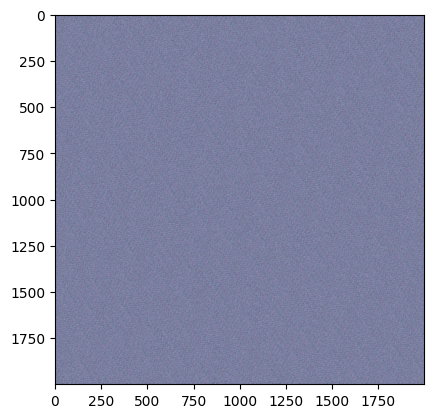

In [ ]:
img_encriptada = iniciar_transformada(itrs_encriptado, "encriptar", img)
plt.imshow(img_encriptada)

### Prueba de **Desencriptado de imagen** 🖼️🔓

Iniciando proceso de desencriptar
Iteración: -40


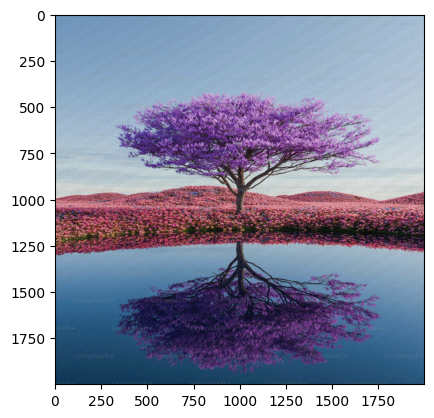

In [ ]:
img_desencriptada = iniciar_transformada(itrs_desencriptado, "desencriptar", img_encriptada)
plt.imshow(img_desencriptada)

# Esteganografía 🖼️🌘

> Procedemos a implementar un algoritmo que nos permita ocultar una imagen dentro de otra imagen.

> [Imagen Portadora, Imagen Oculta]



### Algoritmo (Semi)Esteganográfico 🧮

In [ ]:
## Método de mezclado por patrón ##
def metodo_mezcla_directa(img_portadora, img_oculta, modo: str): # itr_periodo será nuestro periodo para revelar la imagen oculta.
  modo = modo.strip().lower()
  print(f"""
  Modo de imagen: {modo}
  Dimensiones de Imagen Portadora: \033[1m{img_portadora.size[0]}x{img_portadora.size[1]} píxeles\033[0m
  Dimensiones de Imagen Secreta: \033[1m{img_oculta.size[0]}x{img_oculta.size[1]} píxeles\033[0m
  """)
  pxl_portadora = img_portadora.load()
  pxl_oculta = img_oculta.load()
  n = img_oculta.size[0] # La imagen oculta será siempre más pequeña que la imagen original.
#-----------------------------
  for i in range(n):
    for j in range(n):
      img_portadora.load()[i, j] = escribir_pixel_mezcla_drecta(pxl_portadora[i, j], pxl_oculta[i, j], i+j, modo)
  return img_portadora # Portadora_Modificada

def escribir_pixel_mezcla_drecta(pixel_portadora, pixel_oculta, num, modo: str): # Ocuparemos los valores (Bytes) menos significativos para que el cambio (ocultamiento de la imagen) sea
  if modo == "fantasma" and num%2 == 0:
    return (pixel_portadora[0], pixel_portadora[1], pixel_portadora[2]) # R G B (Portadora)
  else:
    return (pixel_oculta[0], pixel_oculta[1], pixel_oculta[2]) # R G B (Oculta)

### Preparación de Imagen a Ocultar  🗞

(2000, 2000)

Escribe el reescalado de la imagen. Debe ser menor a (1500 x 1500) px
1000


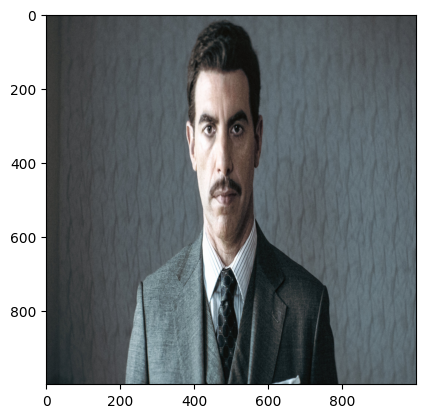

In [ ]:
imagen_portadora = img_encriptada # Imagen Portadora
imagen_oculta = Image.open("hide.jpg") # Imagen a Ocultar

print(imagen_portadora.size)

max_size = .75  # Porcentaje(%)
if (imagen_oculta.size[0]+imagen_oculta.size[1]) >= (imagen_portadora.size[0]+imagen_portadora.size[1])*max_size or imagen_oculta.size[0] != imagen_oculta.size[1]:
  # La imagen a ocultar debe será (por lo general) menor a la imagen original.
  imagen_oculta = imagen_oculta.resize(reescalado_imagen(min(imagen_portadora.size[0]*max_size, imagen_portadora.size[0]*max_size)))

plt.imshow(imagen_oculta)


  Modo de imagen: fantasma
  Dimensiones de Imagen Portadora: 2000x2000 píxeles
  Dimensiones de Imagen Secreta: 1000x1000 píxeles
  


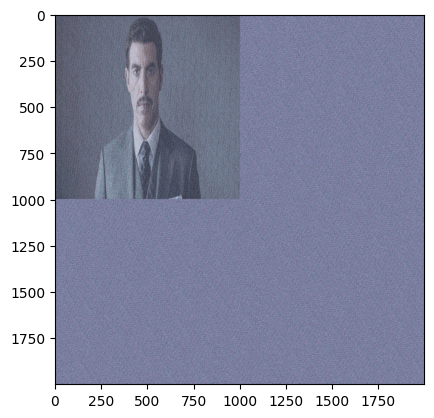

In [ ]:
portadora_modificada_img = metodo_mezcla_directa(imagen_portadora, imagen_oculta, "Fantasma")
plt.imshow(portadora_modificada_img)

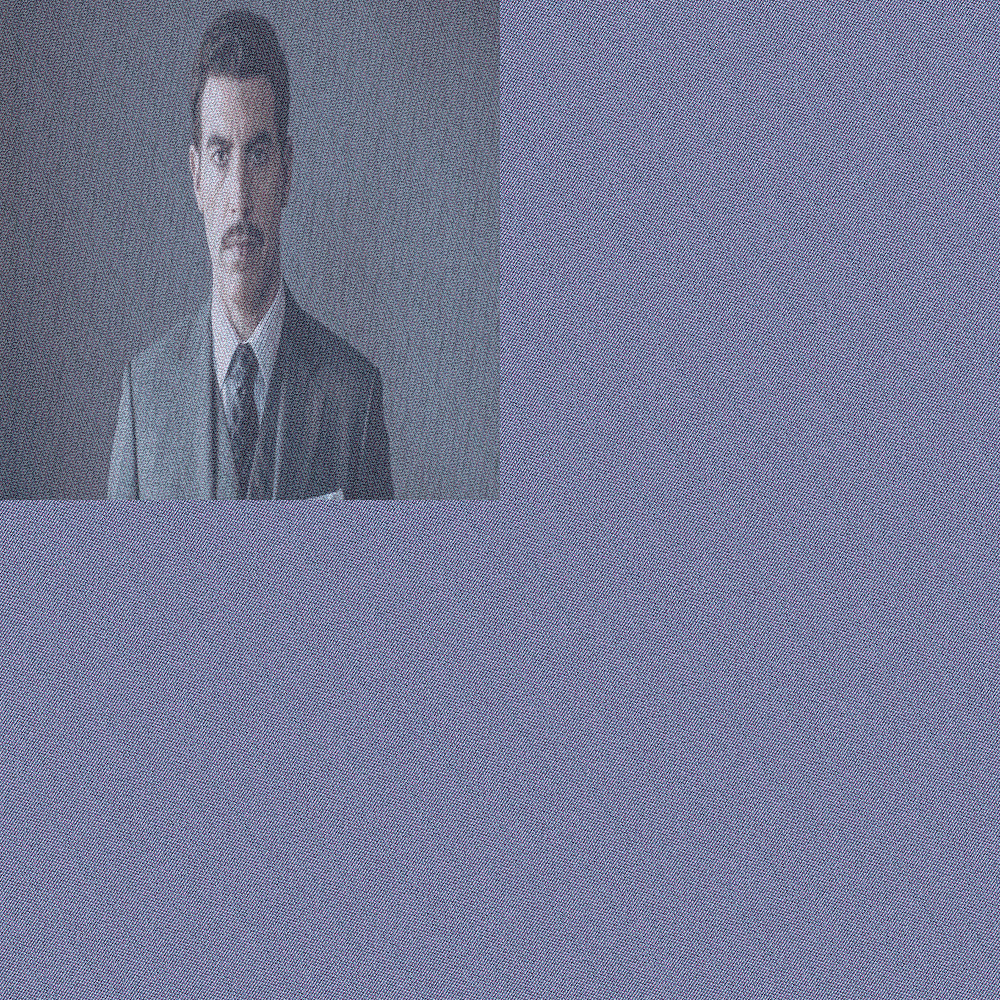

In [ ]:
portadora_modificada_img



---


## Imagen con Imagen Oculta [Final]

Iniciando proceso de desencriptar
Iteración: -40


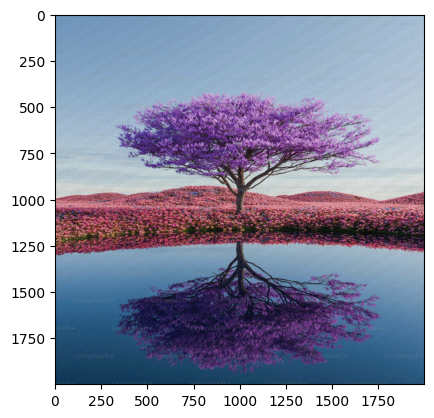

In [ ]:
imagen_oculta_final = iniciar_transformada(itrs_desencriptado, "desencriptar", portadora_modificada_img)
plt.imshow(imagen_oculta_final)

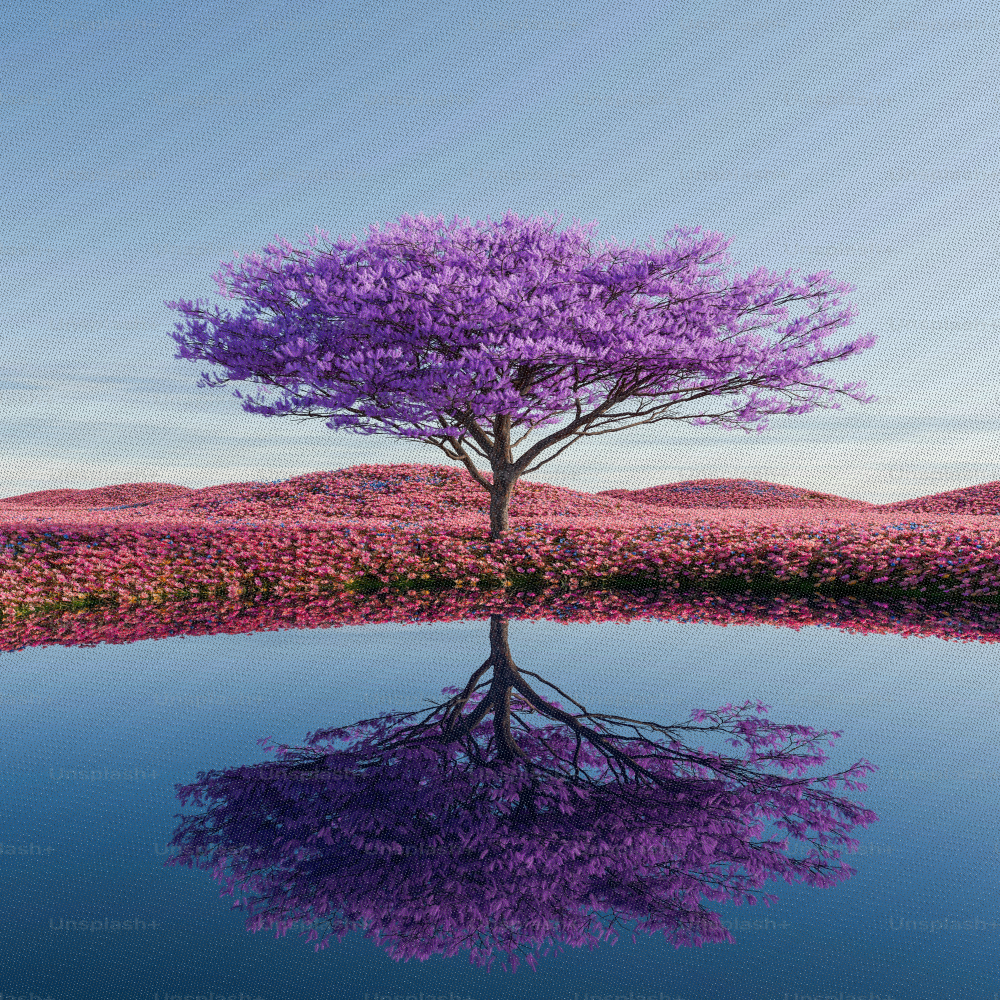

In [ ]:
imagen_oculta_final

In [ ]:
print(bin(255), bin(213), bin(15))

0b11111111 0b11010101 0b1111
